In [ ]:
# source: https://www.kaggle.com/camnugent/sandp500
!wget -nc https://lazyprogrammer.me/course_files/all_stocks_5yr.csv

In [1]:
import pandas as pd

In [2]:
df = pd.read_csv('../data/all_stocks_5yr.csv')

In [3]:
df.head()

,date,open,high,low,close,volume,Name
0,2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
1,2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2,2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
3,2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
4,2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 619040 entries, 0 to 619039
Data columns (total 7 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   date    619040 non-null  object 
 1   open    619029 non-null  float64
 2   high    619032 non-null  float64
 3   low     619032 non-null  float64
 4   close   619040 non-null  float64
 5   volume  619040 non-null  int64  
 6   Name    619040 non-null  object 
dtypes: float64(4), int64(1), object(2)
memory usage: 33.1+ MB


In [5]:
df['Name'].unique()

array(['AAL', 'AAPL', 'AAP', 'ABBV', 'ABC', 'ABT', 'ACN', 'ADBE', 'ADI',
       'ADM', 'ADP', 'ADSK', 'ADS', 'AEE', 'AEP', 'AES', 'AET', 'AFL',
       'AGN', 'AIG', 'AIV', 'AIZ', 'AJG', 'AKAM', 'ALB', 'ALGN', 'ALK',
       'ALLE', 'ALL', 'ALXN', 'AMAT', 'AMD', 'AME', 'AMGN', 'AMG', 'AMP',
       'AMT', 'AMZN', 'ANDV', 'ANSS', 'ANTM', 'AON', 'AOS', 'APA', 'APC',
       'APD', 'APH', 'APTV', 'ARE', 'ARNC', 'ATVI', 'AVB', 'AVGO', 'AVY',
       'AWK', 'AXP', 'AYI', 'AZO', 'A', 'BAC', 'BAX', 'BA', 'BBT', 'BBY',
       'BDX', 'BEN', 'BF.B', 'BHF', 'BHGE', 'BIIB', 'BK', 'BLK', 'BLL',
       'BMY', 'BRK.B', 'BSX', 'BWA', 'BXP', 'CAG', 'CAH', 'CAT', 'CA',
       'CBG', 'CBOE', 'CBS', 'CB', 'CCI', 'CCL', 'CDNS', 'CELG', 'CERN',
       'CFG', 'CF', 'CHD', 'CHK', 'CHRW', 'CHTR', 'CINF', 'CI', 'CLX',
       'CL', 'CMA', 'CMCSA', 'CME', 'CMG', 'CMI', 'CMS', 'CNC', 'CNP',
       'COF', 'COG', 'COL', 'COO', 'COP', 'COST', 'COTY', 'CPB', 'CRM',
       'CSCO', 'CSRA', 'CSX', 'CTAS', 'CTL', 'CTSH', 'CTXS

In [6]:
df['Name'].unique().shape

(505,)

## Working with a single stock

In [7]:
df[df['Name'] == 'IBM']

,date,open,high,low,close,volume,Name
290491,2013-02-08,199.97,202.090,199.6800,201.68,2893254,IBM
290492,2013-02-11,200.98,201.950,199.7500,200.16,2944651,IBM
290493,2013-02-12,200.01,200.735,199.0200,200.04,2461779,IBM
290494,2013-02-13,200.65,200.950,199.5700,200.09,2169757,IBM
290495,2013-02-14,199.73,200.320,199.2600,199.65,3294126,IBM
...,...,...,...,...,...,...,...
291745,2018-02-01,163.19,164.130,161.9000,162.40,4434242,IBM
291746,2018-02-02,161.70,162.000,158.8663,159.03,5251938,IBM
291747,2018-02-05,157.89,158.500,150.0000,152.53,8746599,IBM
291748,2018-02-06,150.29,155.490,149.1100,155.34,9867678,IBM


In [8]:
ibm = df[df['Name'] == 'IBM']
ibm['close']

290491    201.68
290492    200.16
290493    200.04
290494    200.09
290495    199.65
           ...  
291745    162.40
291746    159.03
291747    152.53
291748    155.34
291749    153.85
Name: close, Length: 1259, dtype: float64

<AxesSubplot:>

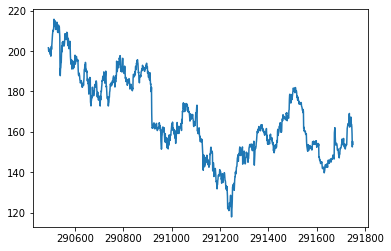

In [9]:
ibm['close'].plot()

## Working with multiple stocks - all on *close* column

In [10]:
df['date'].min(), df['date'].max()

('2013-02-08', '2018-02-07')

In [11]:
dates = pd.date_range(df['date'].min(), df['date'].max())
dates

DatetimeIndex(['2013-02-08', '2013-02-09', '2013-02-10', '2013-02-11',
               '2013-02-12', '2013-02-13', '2013-02-14', '2013-02-15',
               '2013-02-16', '2013-02-17',
               ...
               '2018-01-29', '2018-01-30', '2018-01-31', '2018-02-01',
               '2018-02-02', '2018-02-03', '2018-02-04', '2018-02-05',
               '2018-02-06', '2018-02-07'],
              dtype='datetime64[ns]', length=1826, freq='D')

In [12]:
close_prices = pd.DataFrame(index=dates)
close_prices.index = pd.to_datetime(close_prices.index)

close_prices.head()

""
2013-02-08
2013-02-09
2013-02-10
2013-02-11
2013-02-12


In [13]:
symbols = df['Name'].unique()

In [14]:
df2 = pd.DataFrame(data=ibm['close'].to_numpy(), index=ibm['date'], \
                   columns=['IBM'])
df2.head()

,IBM
date,
2013-02-08,201.68
2013-02-11,200.16
2013-02-12,200.04
2013-02-13,200.09
2013-02-14,199.65


In [15]:
# Joining all symbols on the close column to a single db

for symbol in symbols:
  df_sym = df[df['Name'] == symbol]
  df_tmp = pd.DataFrame(data=df_sym['close'].to_numpy(), \
                        index=df_sym['date'], columns=[symbol])
  df_tmp.index = pd.to_datetime(df_tmp.index)
  close_prices = close_prices.join(df_tmp) # left-join by default

In [16]:
close_prices.head()

,AAL,AAPL,AAP,ABBV,ABC,ABT,ACN,ADBE,ADI,ADM,...,XLNX,XL,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
2013-02-08,14.75,67.8542,78.90,36.25,46.89,34.41,73.31,39.12,45.70,30.22,...,37.51,28.24,88.61,42.87,31.84,27.09,65.30,75.85,24.14,33.05
2013-02-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-02-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-02-11,14.46,68.5614,78.39,35.85,46.76,34.26,73.07,38.64,46.08,30.28,...,37.46,28.31,88.28,42.84,31.96,27.46,64.55,75.65,24.21,33.26
2013-02-12,14.27,66.8428,78.60,35.42,46.96,34.30,73.37,38.89,46.27,30.81,...,37.58,28.41,88.46,42.87,31.84,27.95,64.75,75.44,24.49,33.74


In [17]:
close_prices.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1826 entries, 2013-02-08 to 2018-02-07
Freq: D
Columns: 505 entries, AAL to ZTS
dtypes: float64(505)
memory usage: 7.1 MB


In [18]:
close_prices.describe()

,AAL,AAPL,AAP,ABBV,ABC,ABT,ACN,ADBE,ADI,ADM,...,XLNX,XL,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
count,1259.000000,1259.000000,1259.000000,1259.00000,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000,...,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000,1259.000000
mean,38.393252,109.066698,132.433463,60.86444,82.092979,42.940326,101.119079,90.458156,60.931932,42.402113,...,49.833474,35.315099,87.668447,53.821882,40.486807,41.434095,75.451009,105.606291,32.171790,45.098648
std,10.957636,30.556812,31.274463,13.73038,16.315690,5.860169,22.129031,36.997773,13.383631,5.197069,...,9.517797,3.874693,6.959475,7.599269,7.949466,11.319674,7.485003,15.052699,7.673401,11.981390
min,13.020000,55.789900,76.180000,35.27000,46.180000,32.930000,70.280000,38.110000,42.340000,30.220000,...,35.510000,27.960000,68.710000,40.240000,27.520000,24.190000,59.700000,72.380000,19.900000,28.400000
25%,34.330000,84.830650,104.440000,52.65000,70.525000,38.475000,80.670000,65.865000,50.272500,39.265000,...,43.222500,32.175000,82.435000,47.015000,34.400000,34.590000,70.225000,96.075000,27.505000,32.830000
50%,40.870000,109.010000,141.300000,60.17000,82.560000,42.300000,97.770000,80.590000,56.930000,42.880000,...,46.860000,35.010000,87.290000,53.540000,40.000000,37.280000,74.100000,105.970000,29.230000,45.620000
75%,46.535000,127.120000,156.730000,65.74500,92.520000,45.785000,117.045000,105.710000,67.895000,45.650000,...,54.060000,37.770000,92.085000,60.805000,45.480000,49.155000,80.470000,117.315000,32.462500,51.295000
max,58.470000,179.260000,200.380000,123.21000,115.480000,63.420000,162.550000,201.300000,97.240000,53.710000,...,76.300000,46.660000,104.380000,68.580000,57.280000,75.660000,94.880000,133.090000,54.980000,80.090000


In [19]:
close_prices.to_csv('../sp500_close.csv')

## Reading data from CSV file

In [21]:
close2 = pd.read_csv('../sp500_close.csv', index_col=0, parse_dates=True)
close2.head()

,AAL,AAPL,AAP,ABBV,ABC,ABT,ACN,ADBE,ADI,ADM,...,XLNX,XL,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
2013-02-08,14.75,67.8542,78.90,36.25,46.89,34.41,73.31,39.12,45.70,30.22,...,37.51,28.24,88.61,42.87,31.84,27.09,65.30,75.85,24.14,33.05
2013-02-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-02-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-02-11,14.46,68.5614,78.39,35.85,46.76,34.26,73.07,38.64,46.08,30.28,...,37.46,28.31,88.28,42.84,31.96,27.46,64.55,75.65,24.21,33.26
2013-02-12,14.27,66.8428,78.60,35.42,46.96,34.30,73.37,38.89,46.27,30.81,...,37.58,28.41,88.46,42.87,31.84,27.95,64.75,75.44,24.49,33.74


In [22]:
close2.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1826 entries, 2013-02-08 to 2018-02-07
Columns: 505 entries, AAL to ZTS
dtypes: float64(505)
memory usage: 7.0 MB


<AxesSubplot:>

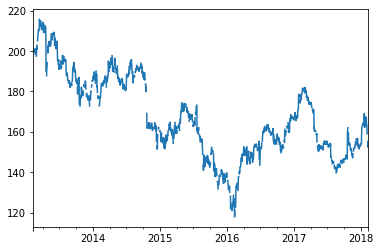

In [23]:
# Data is fine - except for missing values

close_prices['IBM'].plot()

In [24]:
# Drop rows where the whole row is nan 
# (Most likely due to weekends, holidays (non-trading days))

close_prices.dropna(axis=0, how='all', inplace=True)

<AxesSubplot:>

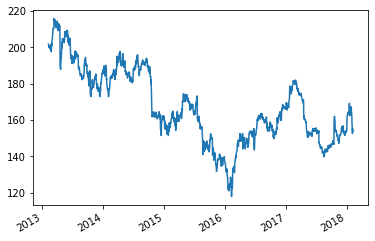

In [25]:
# Much better plot

close_prices['IBM'].plot()

In [26]:
# Check again for missing data

close_prices.isna().sum()

AAL     0
AAPL    0
AAP     0
ABBV    0
ABC     0
       ..
XYL     0
YUM     0
ZBH     0
ZION    0
ZTS     0
Length: 505, dtype: int64

In [27]:
# Amount of still missing values

close_prices.isna().sum().sum()

16755

In [28]:
# Missing values in the first row

close_prices.iloc[0, :].isna().sum()

29

In [29]:
# Forward fill existing missing data (safer than backfilling until neccessary)

close_prices.fillna(method='ffill', inplace=True)

In [30]:
# Amount of missing values after ffill

close_prices.isna().sum().sum()

16704

In [31]:
# Backfill the still missing data - data that didn't have previous values (not traded before date X)

close_prices.fillna(method='bfill', inplace=True)

In [32]:
# No more missing data!

close_prices.isna().sum().sum()

0

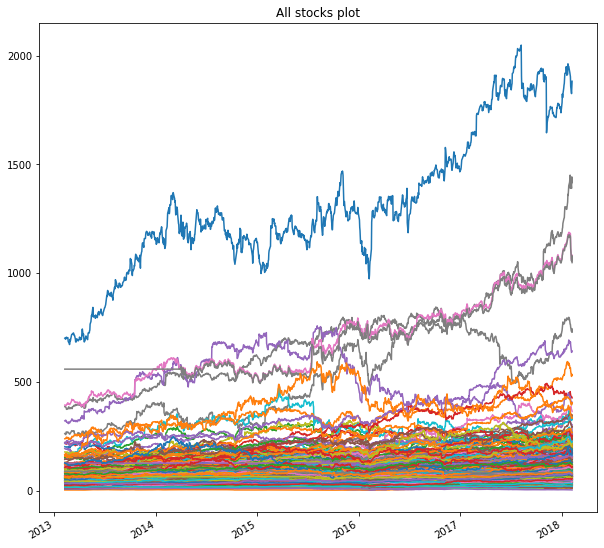

In [33]:
close_prices.plot(legend=False, figsize=(10, 10), title='All stocks plot');

In [34]:
# Finding the normalized data (dataframe divided by first row of dataframe to get returns)
close_prices_normalized = close_prices / close_prices.iloc[0]

<AxesSubplot:title={'center':'Normalized dataframe plot - all stocks'}>

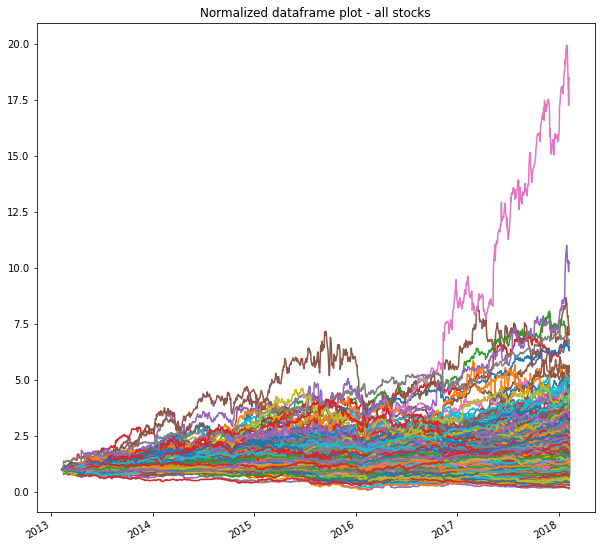

In [35]:
close_prices_normalized.plot(legend=False, figsize=(10, 10), title="Normalized dataframe plot - all stocks")